# Import important packages

In [ ]:
%pip install -qq -U diffusers datasets transformers accelerate ftfy pyarrow==9.0.0 piq

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 28.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.1/542.1 kB 42.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 309.4/309.4 kB 36.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.4/54.4 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.3/35.3 MB 44.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.9/106.9 kB 14.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 42.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 44.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 510.5/510.5 kB 37.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 536.7/536.7 kB 44.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 536.6/536.6 kB 39.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 507.1/507.1 kB 46.8 MB/s eta 0:00:00
     ━━━━━━━━

In [ ]:
%%capture
!sudo apt -qq install git-lfs
!git config --global credential.helper store

# Step 1. Define TDPM-DIP model

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import piq
import numpy as np

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

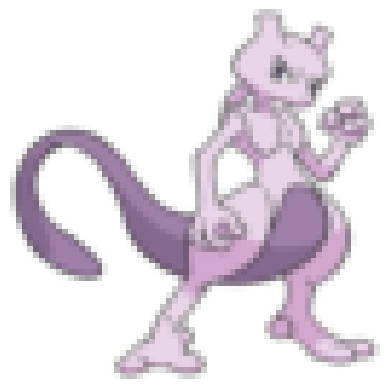

In [ ]:
from torchvision import transforms
from PIL import Image

preprocess = transforms.Compose(
    [
        transforms.Resize((64, 64)),
        transforms.ToTensor(),
        transforms.Normalize([0.5], [0.5]),
    ]
)

image = cv2.imread('mewtwo.png')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_tensor = preprocess(Image.fromarray(image))
plt.imshow(image_tensor.permute(1, 2, 0).numpy() / 2 + 0.5)
plt.axis('off')
plt.show()

In [ ]:
class TDPM_DIP(nn.Module):
    def __init__(self, DDPM, noise_scheduler, truncated_step, device):
        super().__init__()
        self.device = device
        self.DDPM = DDPM.to(self.device)
        self.noise_scheduler = noise_scheduler
        self.truncated_step = truncated_step

    def train_dip(self, x_truncated, noise):

        self.DIP = UNet2DModel(
                 sample_size=64,  # the target image resolution
                 in_channels=3,  # the number of input channels, 3 for RGB images
                 out_channels=3,  # the number of output channels
                 layers_per_block=2,  # how many ResNet layers to use per UNet block
                 block_out_channels=(128, 128, 256, 512),  # the number of output channes for each UNet block
                 down_block_types=(
                    "DownBlock2D",  # a regular ResNet downsampling block
                    "DownBlock2D",
                    "AttnDownBlock2D",  # a ResNet downsampling block with spatial self-attention
                    "DownBlock2D",
                ),
                 up_block_types=(
                    "UpBlock2D",  # a regular ResNet upsampling block
                    "AttnUpBlock2D",  # a ResNet upsampling block with spatial self-attention
                    "UpBlock2D",
                    "UpBlock2D",
                ),
        )

        self.DIP.to(self.device)
        print("Start Training DIP...")

        self.DIP_iterations = 100
        criterion = nn.MSELoss()
        lr = 1e-4
        optimizer = optim.Adam(self.DIP.parameters(), lr=lr)

        for i in tqdm(range(self.DIP_iterations)):
            out = self.DIP(noise, 0).sample
            loss = criterion(out, x_truncated)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            # if (i+1) % 5 == 0:
            #     print("Loss is {}".format(loss.item()))
            #     plt.subplot(1, 2, 1)
            #     pred_np = out.squeeze(0).permute(1, 2, 0).detach().cpu().numpy() / 2 + 0.5
            #     plt.imshow(pred_np)
            #     plt.subplot(1, 2, 2)
            #     plt.imshow(x_truncated.squeeze(0).permute(1, 2, 0).detach().cpu().numpy() / 2 + 0.5)
            #     plt.show()

    def DIP_denoise(self, x_t):
        x_truncated_pred = self.DIP(x_t, 0).sample
        return x_truncated_pred

    def DDPM_reverse_step(self, x_truncated):
        sample = x_truncated
        for t in tqdm(list(range(0, self.truncated_step+1))[::-1]):
           with torch.no_grad():
             residual = self.DDPM(sample, t).sample
           sample = self.noise_scheduler.step(residual, t, sample).prev_sample

        return sample


    def TDPM_reverse(self, x_t):
        '''
           Step 1.  Use DIP to denoise gaussian noise (x_t) to truncated steps (x_truncated)
                    >>> x_truncated = self.DIP_denoise(self, x_t)

           Step 2.  Use DDPM to execute the reverse steps from x_truncated to x_0
                    >>> x_0 = self.DDPM_reverse_step(x_truncated)

           Step 3.  return x_0
                    >>> return x_0
        '''

        x_truncated = self.DIP_denoise(x_t)
        x_0 = self.DDPM_reverse_step(x_truncated)
        return x_0


    def add_to_truncated(self, noise, image):
        truncated_target = self.noise_scheduler.add_noise(image, noise, torch.LongTensor([self.truncated_step]))
        return truncated_target

    def count_denoising_steps(self):
        return self.DIP_iterations + self.truncated_step

    def forward(self, x_t):
        '''
           Same with self.TDPM_reverse(x_t)
           >>> return self.TDPM_reverse(x_t)
        '''
        return self.TDPM_reverse(x_t)


# Step 2. Build TDPM-DIP from pre-trained DDPM

## Load pre-trained DDPM

In [ ]:
import numpy as np
import cv2
from diffusers import DDPMScheduler, UNet2DModel
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms


model = UNet2DModel.from_pretrained("FelixChao/ddpm-pokemon-64-full-steps").to("cuda")
noise_scheduler = DDPMScheduler.from_pretrained("FelixChao/ddpm-pokemon-64-full-steps")

/usr/local/lib/python3.10/dist-packages/diffusers/models/transformers/transformer_2d.py:34: FutureWarning: `Transformer2DModelOutput` is deprecated and will be removed in version 1.0.0. Importing `Transformer2DModelOutput` from `diffusers.models.transformer_2d` is deprecated and this will be removed in a future version. Please use `from diffusers.models.modeling_outputs import Transformer2DModelOutput`, instead.
  deprecate("Transformer2DModelOutput", "1.0.0", deprecation_message)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.w

config.json:   0%|          | 0.00/1.04k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/455M [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/497 [00:00<?, ?B/s]

In [ ]:
TDPM_DIP_model = TDPM_DIP(model, noise_scheduler, 0, device)

In [ ]:
# torch.manual_seed(30)
noise = torch.randn(1, 3, 64, 64).to(device)
x_t = image_tensor.unsqueeze(0).to(device)
x_truncated = TDPM_DIP_model.add_to_truncated(noise, x_t)

## View DIP training as a part of "reverse denoising steps".

In [ ]:
noisy_image = noise_scheduler.add_noise(x_t, noise, torch.LongTensor([600]))
TDPM_DIP_model.train_dip(x_truncated, noisy_image)

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

In [ ]:
x_0 = TDPM_DIP_model.TDPM_reverse(noisy_image)

  0%|          | 0/1 [00:00<?, ?it/s]

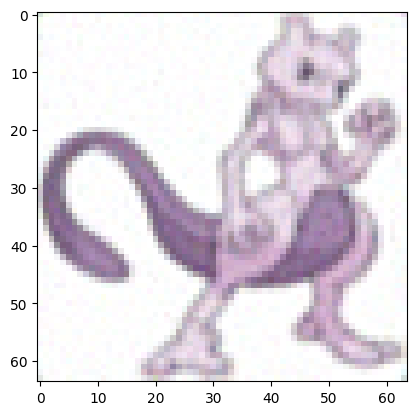

In [ ]:
plt.imshow(x_0.cpu().detach()[0].permute(1, 2, 0).numpy() / 2 + 0.5)
plt.show()

In [ ]:
print("Total Equivalent Denoising Steps:", TDPM_DIP_model.count_denoising_steps())

Total Equivalent Denoising Steps: 100


## Test the quality of the single image

In [ ]:
import piq

def psnr_eval(x, y):
    psnr = piq.psnr(x, y, data_range=1., reduction='none')
    return psnr

def ssim_eval(x, y):
    ssim = piq.ssim(x, y, data_range=1.)
    return ssim

In [ ]:
print(f"PSNR: {psnr_eval(torch.from_numpy(x_0.cpu().detach().numpy() / 2 + 0.5), torch.from_numpy((image_tensor.unsqueeze(0).detach().numpy() / 2 + 0.5))).item():.4f}")
print(f"SSIM: {ssim_eval(torch.from_numpy(x_0.cpu().detach().numpy() / 2 + 0.5),  torch.from_numpy((image_tensor.unsqueeze(0).detach().numpy() / 2 + 0.5))).item():.4f}")

PSNR: 31.4777
SSIM: 0.9573


# Step 3. Evaluation

## Download Dataset and transform to Tensor

In [ ]:
!pip install torchmetrics
!pip install torch-fidelity

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 868.8/868.8 kB 19.5 MB/s eta 0:00:00


In [ ]:
from datasets import load_dataset

dataset_name = "huggan/pokemon"
dataset = load_dataset(dataset_name, split="train")
dataset

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Repo card metadata block was not found. Setting CardData to empty.


Generating train split:   0%|          | 0/7357 [00:00<?, ? examples/s]

Dataset({
    features: ['image'],
    num_rows: 7357
})

In [ ]:
from torchvision import transforms

preprocess = transforms.Compose(
    [
        transforms.Resize((64, 64)),
        transforms.ToTensor(),
    ]
)

def transform(examples):
    images = [preprocess(image.convert("RGB")) for image in examples["image"]]
    return {"images": images}

dataset.set_transform(transform)

In [ ]:
tensor_dataset = torch.stack([x["images"] for x in dataset], dim=0)

In [ ]:
tensor_dataset = tensor_dataset[:1000]

In [ ]:
tensor_dataset.shape

torch.Size([1000, 3, 64, 64])

## Evaluate DDPM and TDPM-DIP on Image Generation

### DDPM only

In [ ]:
import torch
from torchmetrics.image.fid import FrechetInceptionDistance

fid = FrechetInceptionDistance(normalize=True,input_img_size=(3, 64, 64))
fid.update(tensor_dataset, real=True)

Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:00<00:00, 408MB/s]


In [ ]:
predict = []

for i in range(5):
   sample = torch.randn((200,3,64,64)).to("cuda")

   for t in tqdm(list(range(0, 1000))[::-1]):
        with torch.no_grad():
             residual = model(sample, t).sample
        sample = noise_scheduler.step(residual, t, sample).prev_sample

   sample = sample.to("cpu")
   predict.append((sample.detach() / 2 + 0.5).clip(0,1))

   fid.update((sample.detach() / 2 + 0.5).clip(0,1), real=False)

In [ ]:
fid.compute()

tensor(69.0500)

### TDPM-DIP

In [ ]:
import torch
from torchmetrics.image.fid import FrechetInceptionDistance

fid = FrechetInceptionDistance(normalize=True,input_img_size=(3, 64, 64))
fid.update(tensor_dataset, real=True)

In [ ]:
TDPM_DIP_model = TDPM_DIP(model, noise_scheduler, 10, device)

In [ ]:
predict = []

for i in tqdm(range(1000)):
  noise = torch.randn((1,3,64,64)).to("cuda")
  x_0 = ((tensor_dataset[i] - 0.5) / 0.5).unsqueeze(0).to("cuda")
  x_truncated = TDPM_DIP_model.add_to_truncated(noise,x_0)
  TDPM_DIP_model.train_dip(x_truncated, noise)

  sample = TDPM_DIP_model.TDPM_reverse(noise)

  sample = sample.to("cpu")
  predict.append((sample.detach() / 2 + 0.5).clip(0,1))

  fid.update((sample.detach() / 2 + 0.5).clip(0,1), real=False)

  0%|          | 0/1000 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...
Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

In [ ]:
fid.compute()

tensor(20.1198)

## Evaluate TDPM-DIP, DDPM, and DIP on image restoration

### Image Denoising

In [ ]:
TDPM_DIP_model = TDPM_DIP(model, noise_scheduler, 0, device)

In [ ]:
predict = []

for i in tqdm(range(200)):
  noise = torch.randn((1,3,64,64)).to("cuda")
  x_0 = ((tensor_dataset[i] - 0.5) / 0.5).unsqueeze(0).to("cuda")
  #prepare destroy image from random noise
  noisy_image = noise_scheduler.add_noise(x_0, noise, torch.LongTensor([600]))
  x_truncated = TDPM_DIP_model.add_to_truncated(noise,x_0)

  TDPM_DIP_model.train_dip(x_truncated, noisy_image)

  sample = TDPM_DIP_model.TDPM_reverse(noisy_image)

  sample = sample.to("cpu")
  predict.append((sample.detach() / 2 + 0.5).clip(0,1))

  0%|          | 0/200 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
from torchmetrics.image import StructuralSimilarityIndexMeasure
from torchmetrics.image import PeakSignalNoiseRatio

psnr = PeakSignalNoiseRatio(data_range=1.0)
ssim = StructuralSimilarityIndexMeasure(data_range=1.0)

predict = torch.stack(predict, dim=0)
predict = predict.view(-1,3,64,64)
print(psnr(predict, tensor_dataset[:200]))
print(ssim(predict, tensor_dataset[:200]))

tensor(32.1220)
tensor(0.9476)


In [ ]:
TDPM_DIP_model = TDPM_DIP(model, noise_scheduler, 10, device)

In [ ]:
predict = []

for i in tqdm(range(200)):
  noise = torch.randn((1,3,64,64)).to("cuda")
  x_0 = ((tensor_dataset[i] - 0.5) / 0.5).unsqueeze(0).to("cuda")
  #prepare destroy image from random noise
  noisy_image = noise_scheduler.add_noise(x_0, noise, torch.LongTensor([600]))
  x_truncated = TDPM_DIP_model.add_to_truncated(noise,x_0)

  TDPM_DIP_model.train_dip(x_truncated, noisy_image)

  sample = TDPM_DIP_model.TDPM_reverse(noisy_image)

  sample = sample.to("cpu")
  predict.append((sample.detach() / 2 + 0.5).clip(0,1))

  0%|          | 0/200 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

In [ ]:
from torchmetrics.image import StructuralSimilarityIndexMeasure
from torchmetrics.image import PeakSignalNoiseRatio

psnr = PeakSignalNoiseRatio(data_range=1.0)
ssim = StructuralSimilarityIndexMeasure(data_range=1.0)

predict = torch.stack(predict, dim=0)
predict = predict.view(-1,3,64,64)
print(psnr(predict, tensor_dataset[:200]))
print(ssim(predict, tensor_dataset[:200]))

tensor(32.6298)
tensor(0.9699)


In [ ]:
predict = []

x_0 = ((tensor_dataset[:200] - 0.5) / 0.5).to("cuda")
noise = torch.randn((200,3,64,64)).to("cuda")
sample = noise_scheduler.add_noise(x_0, noise, torch.LongTensor([600]))

for t in tqdm(list(range(0, 601))[::-1]):
      with torch.no_grad():
             residual = model(sample, t).sample
      sample = noise_scheduler.step(residual, t, sample).prev_sample

sample = sample.to("cpu")
predict.append((sample.detach() / 2 + 0.5).clip(0,1))

  0%|          | 0/601 [00:00<?, ?it/s]

In [ ]:
from torchmetrics.image import StructuralSimilarityIndexMeasure
from torchmetrics.image import PeakSignalNoiseRatio

psnr = PeakSignalNoiseRatio(data_range=1.0)
ssim = StructuralSimilarityIndexMeasure(data_range=1.0)

predict = torch.stack(predict, dim=0)
predict = predict.view(-1,3,64,64)
print(psnr(predict, tensor_dataset[:200]))
print(ssim(predict, tensor_dataset[:200]))

tensor(13.4031)
tensor(0.3688)


In [ ]:
TDPM_DIP_model = TDPM_DIP(model, noise_scheduler, 10, device)

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

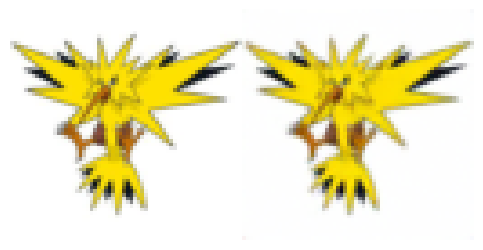

In [ ]:
for i in tqdm(range(363,364)):
  figure = plt.figure(figsize=(15, 6))
  torch.manual_seed(10)
  noise = torch.randn((1,3,64,64)).to("cuda")
  x_0 = ((tensor_dataset[i] - 0.5) / 0.5).unsqueeze(0).to("cuda")
  figure.add_subplot(2, 5, 1)
  plt.imshow(tensor_dataset[i].permute(1, 2, 0).numpy())
  plt.axis('off')

  #prepare destroy image from random noise
  noisy_image = noise_scheduler.add_noise(x_0, noise, torch.LongTensor([600]))
  x_truncated = TDPM_DIP_model.add_to_truncated(noise,x_0)


  TDPM_DIP_model.train_dip(x_truncated, noisy_image)

  sample = TDPM_DIP_model.TDPM_reverse(noisy_image)

  sample = sample.to("cpu")
  figure.add_subplot(2, 5, 2)
  plt.imshow(sample[0].permute(1, 2, 0).detach().numpy() / 2 + 0.5)
  plt.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

In [ ]:
TDPM_DIP_model = TDPM_DIP(model, noise_scheduler, 0, device)

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

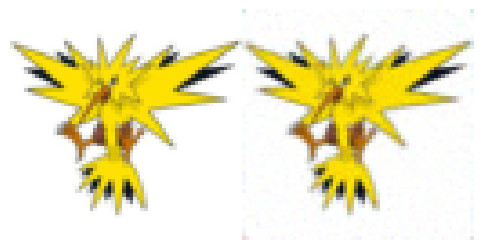

In [ ]:
for i in tqdm(range(363,364)):
  figure = plt.figure(figsize=(15, 6))
  torch.manual_seed(10)
  noise = torch.randn((1,3,64,64)).to("cuda")
  x_0 = ((tensor_dataset[i] - 0.5) / 0.5).unsqueeze(0).to("cuda")
  figure.add_subplot(2, 5, 1)
  plt.imshow(tensor_dataset[i].permute(1, 2, 0).numpy())
  plt.axis('off')

  #prepare destroy image from random noise
  noisy_image = noise_scheduler.add_noise(x_0, noise, torch.LongTensor([600]))
  x_truncated = TDPM_DIP_model.add_to_truncated(noise,x_0)

  TDPM_DIP_model.train_dip(x_truncated, noisy_image)

  sample = TDPM_DIP_model.TDPM_reverse(noisy_image)

  sample = sample.to("cpu")
  figure.add_subplot(2, 5, 2)
  plt.imshow(sample[0].permute(1, 2, 0).detach().numpy() / 2 + 0.5)
  plt.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

  0%|          | 0/601 [00:00<?, ?it/s]

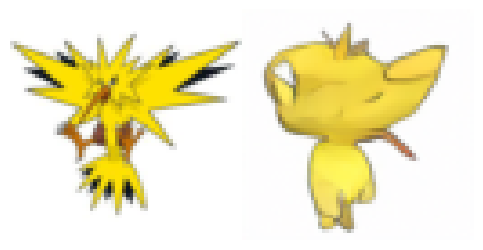

In [ ]:
figure = plt.figure(figsize=(15, 6))
x_0 = ((tensor_dataset[363:364] - 0.5) / 0.5).to("cuda")
torch.manual_seed(10)
noise = torch.randn((1,3,64,64)).to("cuda")
sample = noise_scheduler.add_noise(x_0, noise, torch.LongTensor([600]))

figure.add_subplot(2, 5, 1)
plt.imshow(tensor_dataset[363].permute(1, 2, 0).numpy())
plt.axis('off')

for t in tqdm(list(range(0, 601))[::-1]):
      with torch.no_grad():
             residual = model(sample, t).sample
      sample = noise_scheduler.step(residual, t, sample).prev_sample

sample = sample.to("cpu")

figure.add_subplot(2, 5, 2)
plt.imshow(sample[0].permute(1, 2, 0).detach().numpy() / 2 + 0.5)
plt.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
plt.show()

## Ablation Study

### Impact on Truncated Steps

In [ ]:
TDPM_DIP_model = TDPM_DIP(model, noise_scheduler, 5, device)

In [ ]:
predict = []

for i in tqdm(range(200)):
  noise = torch.randn((1,3,64,64)).to("cuda")
  x_0 = ((tensor_dataset[i] - 0.5) / 0.5).unsqueeze(0).to("cuda")
  #prepare destroy image from random noise
  noisy_image = noise_scheduler.add_noise(x_0, noise, torch.LongTensor([600]))
  x_truncated = TDPM_DIP_model.add_to_truncated(noise,x_0)

  TDPM_DIP_model.train_dip(x_truncated, noisy_image)

  sample = TDPM_DIP_model.TDPM_reverse(noisy_image)

  sample = sample.to("cpu")
  predict.append((sample.detach() / 2 + 0.5).clip(0,1))

  0%|          | 0/200 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

In [ ]:
from torchmetrics.image import StructuralSimilarityIndexMeasure
from torchmetrics.image import PeakSignalNoiseRatio

psnr = PeakSignalNoiseRatio(data_range=1.0)
ssim = StructuralSimilarityIndexMeasure(data_range=1.0)

predict = torch.stack(predict, dim=0)
predict = predict.view(-1,3,64,64)
print(psnr(predict, tensor_dataset[:200]))
print(ssim(predict, tensor_dataset[:200]))

tensor(32.7697)
tensor(0.9702)


In [ ]:
TDPM_DIP_model = TDPM_DIP(model, noise_scheduler, 50, device)

In [ ]:
predict = []

for i in tqdm(range(200)):
  noise = torch.randn((1,3,64,64)).to("cuda")
  x_0 = ((tensor_dataset[i] - 0.5) / 0.5).unsqueeze(0).to("cuda")
  #prepare destroy image from random noise
  noisy_image = noise_scheduler.add_noise(x_0, noise, torch.LongTensor([600]))
  x_truncated = TDPM_DIP_model.add_to_truncated(noise,x_0)

  TDPM_DIP_model.train_dip(x_truncated, noisy_image)

  sample = TDPM_DIP_model.TDPM_reverse(noisy_image)

  sample = sample.to("cpu")
  predict.append((sample.detach() / 2 + 0.5).clip(0,1))

  0%|          | 0/200 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

In [ ]:
from torchmetrics.image import StructuralSimilarityIndexMeasure
from torchmetrics.image import PeakSignalNoiseRatio

psnr = PeakSignalNoiseRatio(data_range=1.0)
ssim = StructuralSimilarityIndexMeasure(data_range=1.0)

predict = torch.stack(predict, dim=0)
predict = predict.view(-1,3,64,64)
print(psnr(predict, tensor_dataset[:200]))
print(ssim(predict, tensor_dataset[:200]))

tensor(28.7032)
tensor(0.9372)


### Impact on Noise Scheduler

#### Cosine Scheduler

In [ ]:
import numpy as np
import cv2
from diffusers import DDPMScheduler, UNet2DModel
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms

model = UNet2DModel.from_pretrained("FelixChao/ddpm-pokemon-64-cosine").to("cuda")
noise_scheduler = DDPMScheduler.from_pretrained("FelixChao/ddpm-pokemon-64-cosine")

/usr/local/lib/python3.10/dist-packages/diffusers/models/transformers/transformer_2d.py:34: FutureWarning: `Transformer2DModelOutput` is deprecated and will be removed in version 1.0.0. Importing `Transformer2DModelOutput` from `diffusers.models.transformer_2d` is deprecated and this will be removed in a future version. Please use `from diffusers.models.modeling_outputs import Transformer2DModelOutput`, instead.
  deprecate("Transformer2DModelOutput", "1.0.0", deprecation_message)


config.json:   0%|          | 0.00/1.04k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/455M [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/508 [00:00<?, ?B/s]

In [ ]:
TDPM_DIP_model = TDPM_DIP(model, noise_scheduler, 0, device)

  0%|          | 0/200 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

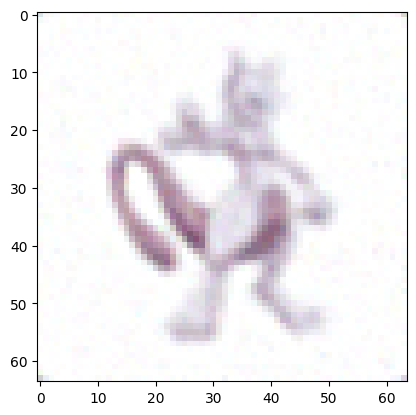

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

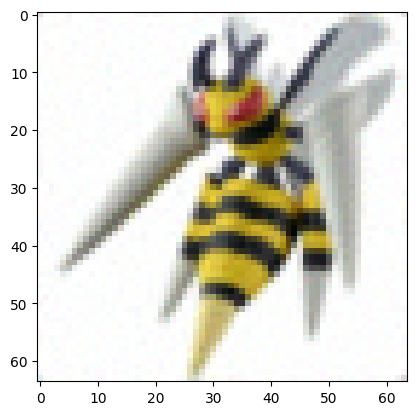

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
predict = []

for i in tqdm(range(200)):
  noise = torch.randn((1,3,64,64)).to("cuda")
  x_0 = ((tensor_dataset[i] - 0.5) / 0.5).unsqueeze(0).to("cuda")
  #prepare destroy image from random noise
  noisy_image = noise_scheduler.add_noise(x_0, noise, torch.LongTensor([600]))
  x_truncated = TDPM_DIP_model.add_to_truncated(noise,x_0)

  TDPM_DIP_model.train_dip(x_truncated, noisy_image)

  sample = TDPM_DIP_model.TDPM_reverse(noisy_image)

  sample = sample.to("cpu")

  if i % 100 == 0:
     plt.imshow(sample[0].permute(1, 2, 0).detach().numpy() / 2 + 0.5)
     plt.show()

  predict.append((sample.detach() / 2 + 0.5).clip(0,1))

In [ ]:
from torchmetrics.image import StructuralSimilarityIndexMeasure
from torchmetrics.image import PeakSignalNoiseRatio

psnr = PeakSignalNoiseRatio(data_range=1.0)
ssim = StructuralSimilarityIndexMeasure(data_range=1.0)

predict = torch.stack(predict, dim=0)
predict = predict.view(-1,3,64,64)
print(psnr(predict, tensor_dataset[:200]))
print(ssim(predict, tensor_dataset[:200]))

tensor(34.3489)
tensor(0.9618)


In [ ]:
TDPM_DIP_model = TDPM_DIP(model, noise_scheduler, 10, device)

  0%|          | 0/200 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

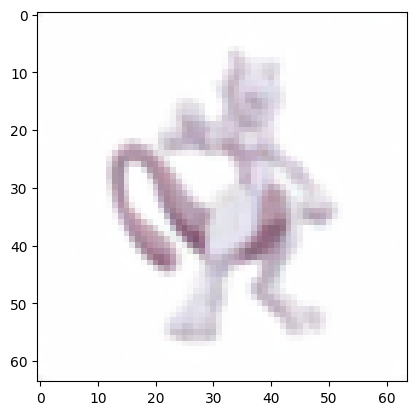

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

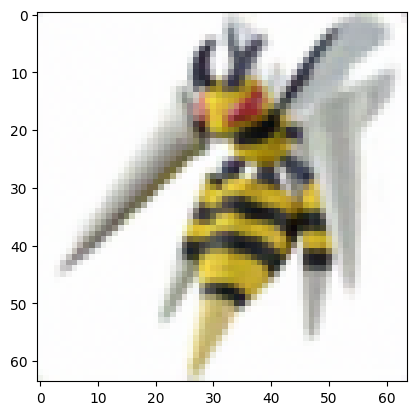

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

Start Training DIP...


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

In [ ]:
predict = []

for i in tqdm(range(200)):
  noise = torch.randn((1,3,64,64)).to("cuda")
  x_0 = ((tensor_dataset[i] - 0.5) / 0.5).unsqueeze(0).to("cuda")
  #prepare destroy image from random noise
  noisy_image = noise_scheduler.add_noise(x_0, noise, torch.LongTensor([600]))
  x_truncated = TDPM_DIP_model.add_to_truncated(noise,x_0)

  TDPM_DIP_model.train_dip(x_truncated, noisy_image)

  sample = TDPM_DIP_model.TDPM_reverse(noisy_image)

  sample = sample.to("cpu")

  if i % 100 == 0:
     plt.imshow(sample[0].permute(1, 2, 0).detach().numpy() / 2 + 0.5)
     plt.show()

  predict.append((sample.detach() / 2 + 0.5).clip(0,1))

In [ ]:
from torchmetrics.image import StructuralSimilarityIndexMeasure
from torchmetrics.image import PeakSignalNoiseRatio

psnr = PeakSignalNoiseRatio(data_range=1.0)
ssim = StructuralSimilarityIndexMeasure(data_range=1.0)

predict = torch.stack(predict, dim=0)
predict = predict.view(-1,3,64,64)
print(psnr(predict, tensor_dataset[:200]))
print(ssim(predict, tensor_dataset[:200]))

tensor(34.7565)
tensor(0.9790)


In [ ]:
predict = []

x_0 = ((tensor_dataset[:200] - 0.5) / 0.5).to("cuda")
noise = torch.randn((200,3,64,64)).to("cuda")
sample = noise_scheduler.add_noise(x_0, noise, torch.LongTensor([600]))

for t in tqdm(list(range(0, 601))[::-1]):
      with torch.no_grad():
             residual = model(sample, t).sample
      sample = noise_scheduler.step(residual, t, sample).prev_sample

sample = sample.to("cpu")
predict.append((sample.detach() / 2 + 0.5).clip(0,1))

  0%|          | 0/601 [00:00<?, ?it/s]

In [ ]:
from torchmetrics.image import StructuralSimilarityIndexMeasure
from torchmetrics.image import PeakSignalNoiseRatio

psnr = PeakSignalNoiseRatio(data_range=1.0)
ssim = StructuralSimilarityIndexMeasure(data_range=1.0)

predict = torch.stack(predict, dim=0)
predict = predict.view(-1,3,64,64)
print(psnr(predict, tensor_dataset[:200]))
print(ssim(predict, tensor_dataset[:200]))

tensor(18.6760)
tensor(0.6590)
